# Gonzalo de las Heras de Matías. July 2020.
### Universidad Europea de Madrid. Business & Tech School. IBM Master's Degree in Big Data Analytics.
#### Master's thesis:
### ADVANCED DRIVER ASSISTANCE SYSTEM (ADAS) BASED ON AUTOMATIC LEARNING TECHNIQUES FOR THE DETECTION AND TRANSCRIPTION OF VARIABLE MESSAGE SIGNS.

![title](notebook_data/imgs/uem_ibm.png)

#### Imports

In [1]:
from utils_vms import configuration as conf
from utils_vms import visualization
from utils_vms import functions
import pandas as pd
import glob
import matplotlib.pyplot as plt
import cv2
import json
import xmltodict
from keras_retinanet.utils.image import read_image_bgr

%matplotlib inline
%config InlineBackend.figure_format='retina'

In [2]:
paths = glob.glob(conf.PATH_TEST + "imgs/" + '*')
classes = []
xmin = []
xmax = []
ymin = []
ymax = []

for path in paths:
    
    boxes = None
    
    try:
        # XML read.
        xml = open(conf.PATH_TEST + "coordinates/" + str(path.split('/')[-1].split('.')[0]) + ".xml", "r")
        xml_content = xml.read()
        boxes = json.loads(json.dumps(xmltodict.parse(xml_content)))['annotation']['object']['bndbox']
        xml.close()
    except:
        pass
    
    if boxes != None: 
        xmin.append(boxes['xmin'])
        xmax.append(boxes['xmax'])
        ymin.append(boxes['ymin'])
        ymax.append(boxes['ymax'])
    else:
        xmin.append('')
        xmax.append('')
        ymin.append('')
        ymax.append('')
    
    if path.split('/')[-1].split('_')[0] == 'vms':
        classes.append('VMS')
    else:
        classes.append('')

df = pd.DataFrame()
df['image_name'] = paths
df['xmin'] = xmin
df['ymin'] = ymin
df['xmax'] = xmax
df['ymax'] = ymax
df['class_name'] = classes

df.to_csv('annotations_test.csv', index=False, header=None)

df.head()

print("\nAnnotations_validation:\n-----------------------\n")
!head annotations_test.csv


Annotations_validation:
-----------------------

../dataset/images/05_test/imgs/D5RHKJNhw7I_2.jpg,,,,,
../dataset/images/05_test/imgs/vms_D5RHKJNhw7I_19.jpg,303,79,443,140,VMS
../dataset/images/05_test/imgs/D5RHKJNhw7I_29.jpg,,,,,
../dataset/images/05_test/imgs/vms_8ifk3BHz1_c_9.jpg,585,56,799,174,VMS
../dataset/images/05_test/imgs/vms_5972.jpg,1018,1413,1646,1632,VMS
../dataset/images/05_test/imgs/D5RHKJNhw7I_9.jpg,,,,,
../dataset/images/05_test/imgs/vms_6bkOZcBECsk_14.jpg,482,123,681,190,VMS
../dataset/images/05_test/imgs/D5RHKJNhw7I_10.jpg,,,,,
../dataset/images/05_test/imgs/S1DE3pvnG8s_17.jpg,,,,,
../dataset/images/05_test/imgs/S1DE3pvnG8s_59.jpg,,,,,


In [3]:
!keras_retinanet/bin/evaluate.py \
    --convert-model\
    --score-threshold 0 --iou-threshold 0.5 \
    --max-detections 2 csv annotations_test.csv classes.csv 'snapshots/vms_model.h5'

Using TensorFlow backend.
2020-08-02 21:38:37.671594: W tensorflow/stream_executor/platform/default/dso_loader.cc:55] Could not load dynamic library 'libnvinfer.so.6'; dlerror: libnvinfer.so.6: cannot open shared object file: No such file or directory
2020-08-02 21:38:37.671635: W tensorflow/stream_executor/platform/default/dso_loader.cc:55] Could not load dynamic library 'libnvinfer_plugin.so.6'; dlerror: libnvinfer_plugin.so.6: cannot open shared object file: No such file or directory
2020-08-02 21:38:37.671641: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:30] Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
Loading model, this may take a second...
2020-08-02 21:38:38.214631: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2020-08-02 21:38:38.241101: I tensorflow/stream_executor/cuda/cuda_gpu_ex

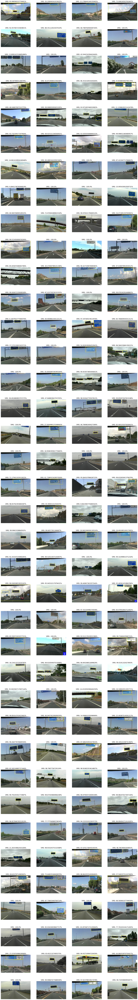

In [4]:
visualization.show_predicted(df, conf.PATH_SNAPSHOTS, len(df.index), False)

### Test

![title](notebook_data/imgs/ty.jpg)